In [1]:
pip install scanpy -q

Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install igraph -q

Note: you may need to restart the kernel to use updated packages.


In [3]:
pip install louvain -q

Note: you may need to restart the kernel to use updated packages.


In [4]:
pip install pandas -q

Note: you may need to restart the kernel to use updated packages.


In [5]:
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [6]:
import warnings
warnings.filterwarnings('ignore')

In [7]:
sc.__version__

'1.9.8'

In [8]:
adata = sc.read_h5ad('AnnDataObject.h5ad')

In [9]:
mask = adata.obs['sample'] == 'enz'
adata = adata[mask, :]

# Quality Control

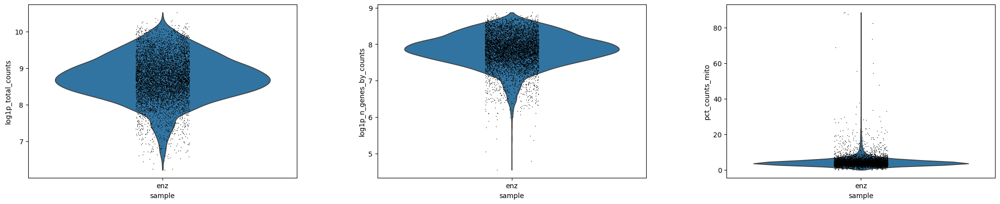

In [10]:
# Violin - genotype - log
sc.pl.violin(
  adata,
  keys=['log1p_total_counts', 'log1p_n_genes_by_counts', 'pct_counts_mito'],
  groupby='sample',
  save='-genotype-log.png'
)

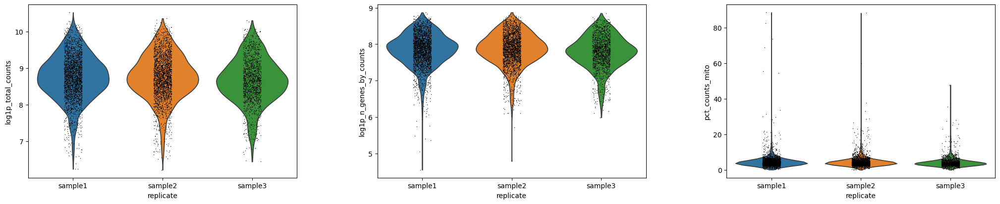

In [11]:
# Violin - sex - log
sc.pl.violin(
  adata,
  keys=['log1p_total_counts', 'log1p_n_genes_by_counts', 'pct_counts_mito'],
  groupby='replicate',
  save='-sex-log.png'
)

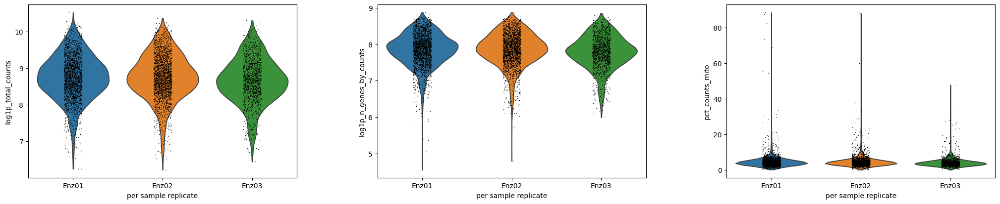

In [12]:
# Violin - sex - log
sc.pl.violin(
  adata,
  keys=['log1p_total_counts', 'log1p_n_genes_by_counts', 'pct_counts_mito'],
  groupby='per_sample_replicate',
  save='-sex-log.png'
)

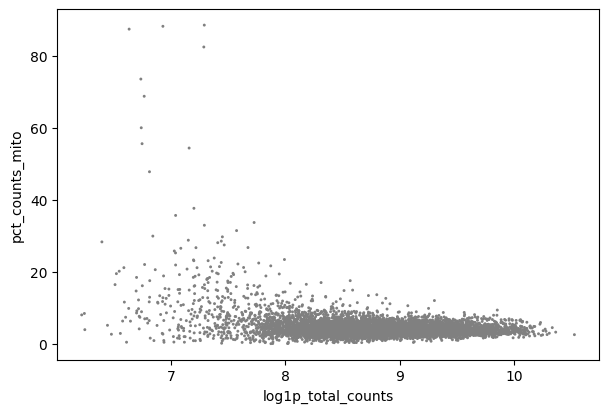

In [13]:
# Scatter - mito x UMIs
sc.pl.scatter(
  adata,
  x='log1p_total_counts',
  y='pct_counts_mito',
  save='-mitoxUMIs.png'
)

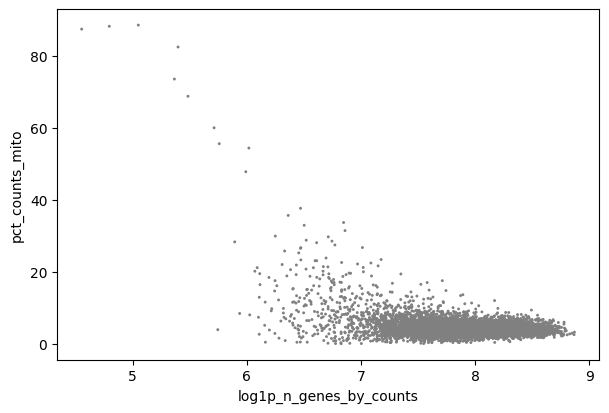

In [14]:
# Scatter - mito x genes
sc.pl.scatter(
  adata,
  x='log1p_n_genes_by_counts',
  y='pct_counts_mito',
  save='-mitoxgenes.png'
)

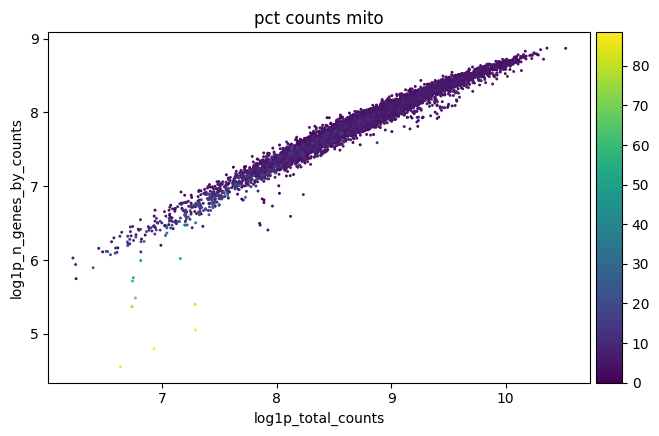

In [15]:
# Scatter - genes x UMIs
sc.pl.scatter(
  adata,
  x='log1p_total_counts',
  y='log1p_n_genes_by_counts',
  color='pct_counts_mito',
  save='-genesxUMIs.png'
)

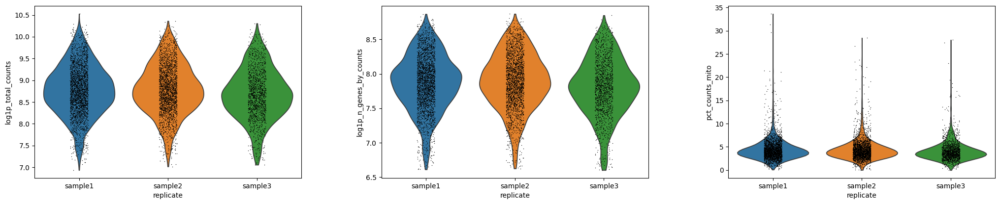

In [16]:
genes_filtered_obj = adata[adata.obs['log1p_n_genes_by_counts'] >= 6.6]
#genes_filtered_obj = genes_filtered_obj[genes_filtered_obj.obs['log1p_n_genes_by_counts'] <= 20.0]

# Violin - Filterbygenes
sc.pl.violin(
  genes_filtered_obj,
  keys=['log1p_total_counts', 'log1p_n_genes_by_counts', 'pct_counts_mito'],
  groupby='replicate',
  save='-Filterbygenes.png'
)

In [17]:
# 17051 × 36601
print(genes_filtered_obj)

View of AnnData object with n_obs × n_vars = 6709 × 36601
    obs: 'batch', 'sample', 'replicate', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts', 'n_genes', 'pct_counts_in_top_50_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'per_sample_replicate'
    var: 'gene_ids', 'feature_types', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts', 'n_cells', 'mito'
    uns: 'sample_colors', 'replicate_colors', 'per_sample_replicate_colors'


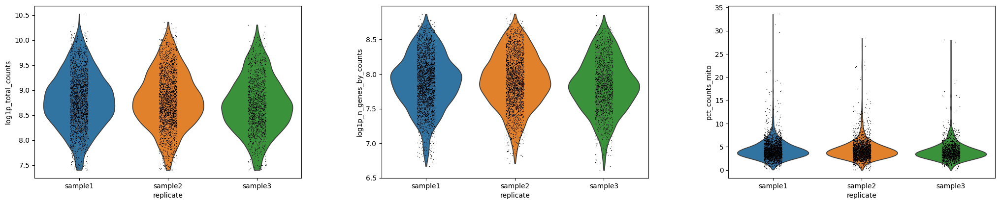

In [18]:
counts_filtered_obj = genes_filtered_obj[genes_filtered_obj.obs['log1p_total_counts'] >=  7.4]
counts_filtered_obj = counts_filtered_obj[counts_filtered_obj.obs['log1p_total_counts'] <= 10.6]

# Violin - Filterbycounts
sc.pl.violin(
  counts_filtered_obj,
  keys=['log1p_total_counts', 'log1p_n_genes_by_counts', 'pct_counts_mito'],
  groupby='replicate',
  save='-Filterbycounts.png'
)

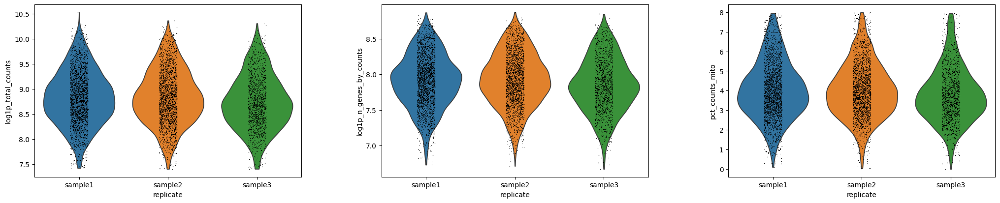

In [19]:
mito_filtered_obj = counts_filtered_obj[counts_filtered_obj.obs['pct_counts_mito'] >=  0]
mito_filtered_obj = mito_filtered_obj[mito_filtered_obj.obs['pct_counts_mito'] <= 8]

# Violin - Filterbymito
sc.pl.violin(
  mito_filtered_obj,
  keys=['log1p_total_counts', 'log1p_n_genes_by_counts', 'pct_counts_mito'],
  groupby='replicate',
  save='-Filterbymito.png'
)

In [20]:
filtered_obj = genes_filtered_obj.copy()

sc.pp.filter_genes(filtered_obj, min_cells=3)
sc.pp.filter_genes(filtered_obj, max_cells=1000000000)

#16803 × 36601
print(filtered_obj)

AnnData object with n_obs × n_vars = 6709 × 24811
    obs: 'batch', 'sample', 'replicate', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts', 'n_genes', 'pct_counts_in_top_50_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'per_sample_replicate'
    var: 'gene_ids', 'feature_types', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts', 'n_cells', 'mito'
    uns: 'sample_colors', 'replicate_colors', 'per_sample_replicate_colors'


In [21]:
out_adata = filtered_obj.copy()

out_adata.X = out_adata.X.astype(int)
out_adata.write_h5ad('anndata-objects/enz-filtered.h5ad')

In [22]:
filtered_obj.var

,gene_ids,feature_types,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts,n_counts,n_cells,mito
AL627309.1,ENSG00000238009,Gene Expression,52,0.003050,0.003045,99.695033,52.0,3.970292,52.0,11,False
AL627309.5,ENSG00000241860,Gene Expression,130,0.007741,0.007712,99.237581,132.0,4.890349,132.0,47,False
AC114498.1,ENSG00000235146,Gene Expression,13,0.000762,0.000762,99.923758,13.0,2.639057,13.0,9,False
LINC01409,ENSG00000237491,Gene Expression,2498,0.173656,0.160123,85.349833,2961.0,7.993620,2961.0,904,False
FAM87B,ENSG00000177757,Gene Expression,33,0.001935,0.001933,99.806463,33.0,3.526361,33.0,4,False
...,...,...,...,...,...,...,...,...,...,...,...
AL354822.1,ENSG00000278384,Gene Expression,2008,0.130960,0.123067,88.223565,2233.0,7.711549,2233.0,758,False
AL592183.1,ENSG00000273748,Gene Expression,1481,0.094892,0.090656,91.314292,1618.0,7.389564,1618.0,574,False
AC240274.1,ENSG00000271254,Gene Expression,953,0.060348,0.058598,94.410885,1029.0,6.937314,1029.0,334,False
AC004556.3,ENSG00000276345,Gene Expression,14,0.000821,0.000821,99.917893,14.0,2.708050,14.0,4,False


# Normalise Data

In [23]:
output_h5ad = filtered_obj.copy()
sc.pp.normalize_total(output_h5ad)

In [24]:
output_h5ad = sc.pp.log1p(output_h5ad, copy=True)  # below function requires log scaled data
sc.pp.highly_variable_genes(output_h5ad)

In [25]:
scaled_data = sc.pp.scale(output_h5ad, max_value=10.0, copy=True)

# Clustering - PCA Components

In [26]:
pca_components = sc.tl.pca(scaled_data, n_comps=50, copy=True)

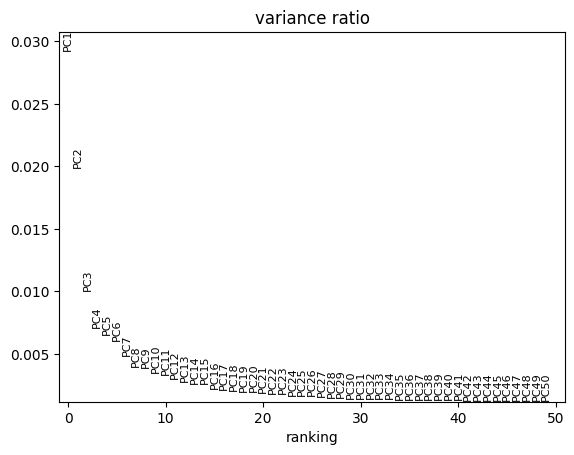

In [27]:
sc.pl.pca_variance_ratio(pca_components, n_pcs=50, save='-variance-ratio.png')

In [29]:
neighbours = sc.pp.neighbors(pca_components, n_neighbors=15, use_rep='X_pca', n_pcs=25, copy=True)

2025-03-02 19:23:06.937330: I tensorflow/core/util/port.cc:111] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-03-02 19:23:06.953296: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-03-02 19:23:06.953313: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-03-02 19:23:06.953327: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-03-02 19:23:06.956663: I tensorflow/core/platform/cpu_feature_g

In [30]:
tsne_components = sc.tl.tsne(neighbours, use_rep='X_pca', perplexity=30, copy=True)

In [31]:
umap_components = sc.tl.umap(tsne_components, copy=True)

# Find Clusters

In [32]:
# Find Clusters
clusters = sc.tl.louvain(umap_components, resolution=0.6, copy=True)

In [33]:
markers_cluster = sc.tl.rank_genes_groups(clusters, groupby="louvain", method='t-test_overestim_var', n_genes=25, copy=True)

In [34]:
markers_genotype = sc.tl.rank_genes_groups(markers_cluster, groupby="sample", method='t-test_overestim_var', n_genes=25, copy=True)

In [35]:
def generate_marker_table(adata):
    # extract marker table metadata
    res = adata.uns['rank_genes_groups']

    # generate DataFrame from metadata
    res_df = pd.DataFrame({
                "genes": pd.DataFrame(res["names"]).stack(),
                "scores": pd.DataFrame(res["scores"]).stack(),
                "logfoldchanges": pd.DataFrame(res["logfoldchanges"]).stack(),
                "pvals": pd.DataFrame(res["pvals"]).stack(),
                "pvals_adj": pd.DataFrame(res["pvals_adj"]).stack(),
            })

    # convert row names to columns
    res_df.index.name = 'newhead'
    res_df.reset_index(inplace=True)

    # rename generic column names
    res_df = res_df.rename(columns={'level_0': 'rank', 'level_1':'cluster'})

    # reorder columns
    res_df = res_df.reindex(columns=['cluster', 'rank', 'genes', 'scores', 'logfoldchanges', 'pvals', 'pvals_adj'])

    # insert ref column
    res_df.insert(2, 'ref', 'rest')

    return res_df

In [36]:
# Generate marker tables
cluster_marker_table = generate_marker_table(markers_cluster)
genotype_marker_table = generate_marker_table(markers_genotype)

display(cluster_marker_table.head(4))
display(genotype_marker_table.head(4))

,cluster,rank,ref,genes,scores,logfoldchanges,pvals,pvals_adj
0,0,0,rest,CAMSAP2,18.480614,NaN,2.296607e-73,5.698112e-69
1,1,0,rest,MIF,29.962934,NaN,4.719155e-166,1.170869e-161
2,2,0,rest,NAALADL2,24.181553,NaN,7.806250e-110,1.936809e-105
3,3,0,rest,STXBP5L,15.287055,NaN,1.796269e-48,4.456723e-44


,cluster,rank,ref,genes,scores,logfoldchanges,pvals,pvals_adj
0,enz,0,rest,AC007325.4,0.0,NaN,1.0,1.0
1,enz,1,rest,KLHDC3,0.0,NaN,1.0,1.0
2,enz,2,rest,FOXP4,0.0,NaN,1.0,1.0
3,enz,3,rest,ZNF318,0.0,NaN,1.0,1.0


## Number of cells per cluster

In [65]:
clusters.obs['louvain'].value_counts()

0    2107
1    1355
2     898
3     774
4     534
5     460
6     435
7     146
Name: louvain, dtype: int64

# Differential Gene Expression Analysis

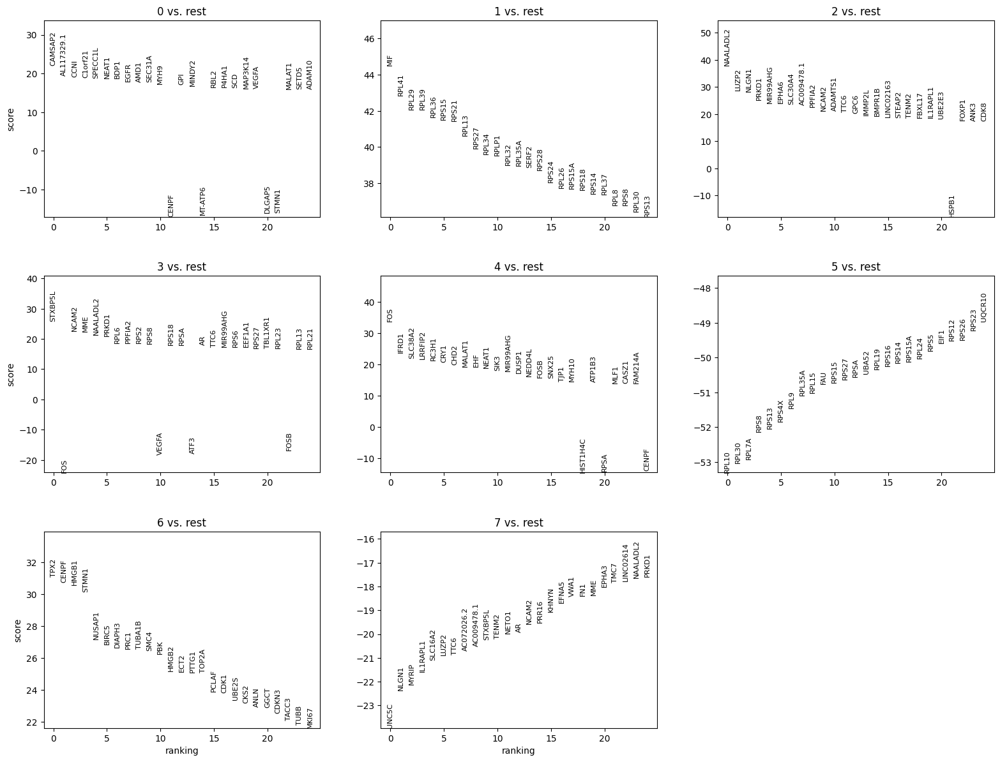

In [37]:
sc.tl.rank_genes_groups(clusters, groupby="louvain", method='t-test', key_added = "t-test", rankby_abs=True)
sc.pl.rank_genes_groups(clusters, n_genes=25, sharey=False, key = "t-test", ncols=3, rankby_abs=True)

In [38]:
degs_df = sc.get.rank_genes_groups_df(clusters, group='7', key="t-test")

#degs_df.head(20)

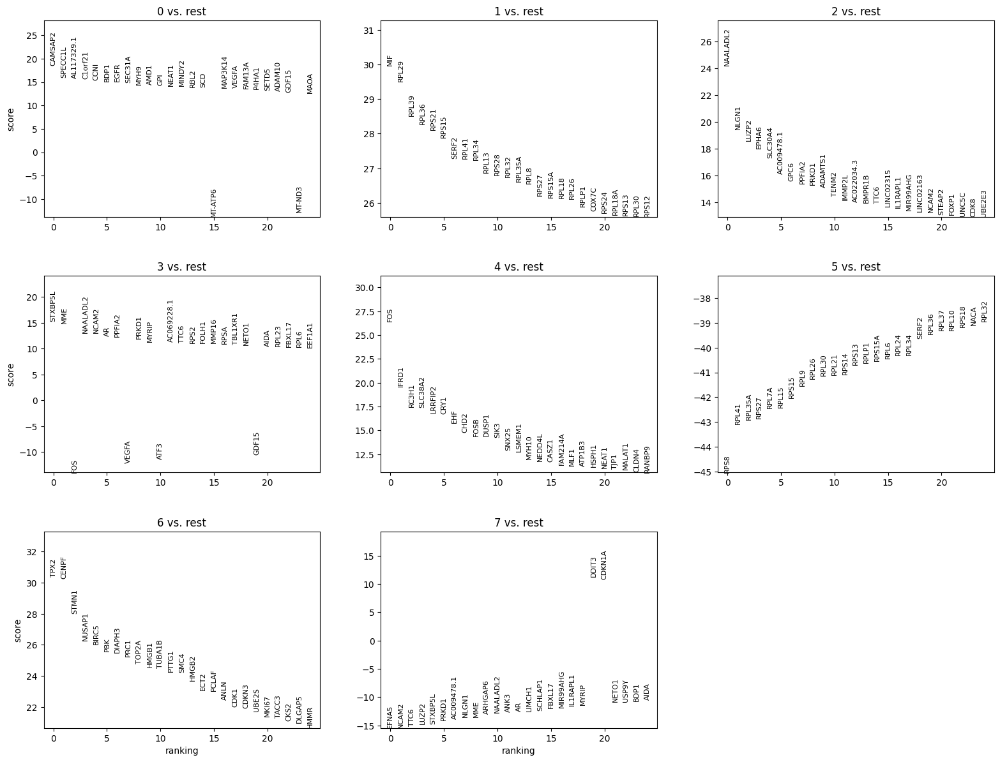

In [39]:
sc.tl.rank_genes_groups(clusters, groupby="louvain", method='t-test_overestim_var', key_added = "t-test_ov", rankby_abs=True)
sc.pl.rank_genes_groups(clusters, n_genes=25, sharey=False, key = "t-test_ov", ncols=3, save="_t-test_ov_enz.png", rankby_abs=True)

In [40]:
gene = 'DDIT3'  # Replace with your gene name
groupby_column = 'louvain'  # Replace with your groupby column in adata.obs

# Extract gene expression values
gene_idx = np.where(clusters.var_names == gene)[0][0]
gene_expression = clusters[:, gene_idx].X.toarray().flatten()

# Create DataFrame with expression and group labels
df = pd.DataFrame({
    'expression': gene_expression,
    'group': clusters.obs[groupby_column].values
})

# Calculate mean expression per group
df.groupby('group')['expression'].mean()

group
0    0.058116
1    0.037893
2   -0.196344
3   -0.255995
4    0.159174
5   -0.465899
6    0.080031
7    2.021662
Name: expression, dtype: float32

In [41]:
degs_df = sc.get.rank_genes_groups_df(clusters, group='7', key="t-test_ov")

degs_df.head(25)
#degs_df.dropna(subset=['logfoldchanges'])

,names,scores,logfoldchanges,pvals,pvals_adj
0,EFNA5,-15.448907,NaN,1.481472e-38,1.685265e-34
1,NCAM2,-15.397781,NaN,4.643563e-39,1.152115e-34
2,TTC6,-15.103625,NaN,2.037723e-38,1.685265e-34
3,LUZP2,-14.810077,NaN,2.431658e-37,1.508296e-33
4,STXBP5L,-14.766930,NaN,3.614736e-37,1.793704e-33
5,PRKD1,-14.107070,NaN,3.051266e-34,1.261749e-30
6,AC009478.1,-13.838775,NaN,1.068946e-33,3.788803e-30
7,NLGN1,-13.561419,NaN,3.141822e-32,8.661306e-29
8,MME,-13.482903,NaN,1.776181e-32,5.508602e-29
9,ARHGAP6,-12.997374,NaN,6.039020e-30,1.498341e-26


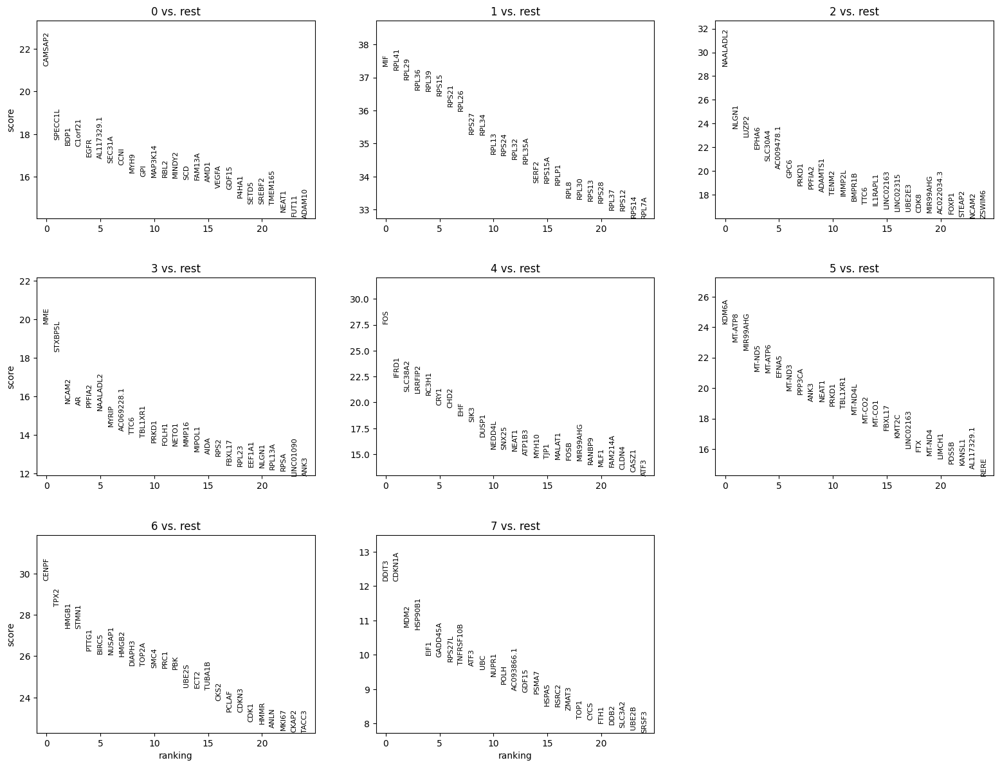

In [42]:
sc.tl.rank_genes_groups(clusters, groupby="louvain", method='wilcoxon', key_added = "wilcoxon")
sc.pl.rank_genes_groups(clusters, n_genes=25, sharey=False, key="wilcoxon", ncols=3)

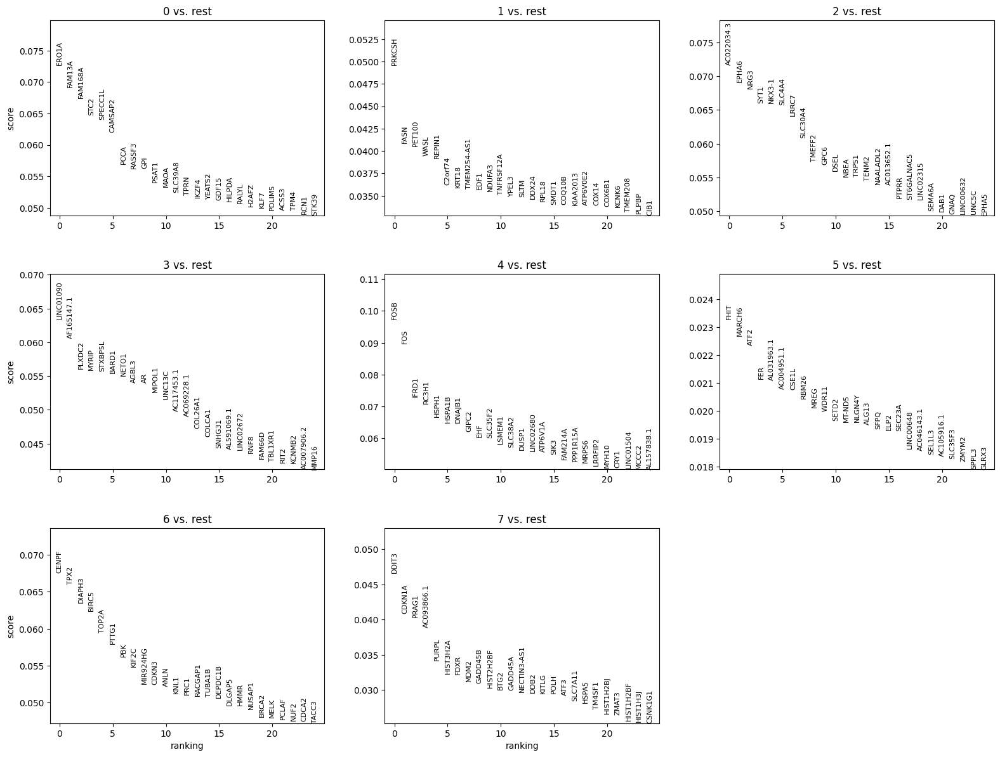

In [43]:
sc.tl.rank_genes_groups(clusters, groupby="louvain", method='logreg',key_added = "logreg")
sc.pl.rank_genes_groups(clusters, n_genes=25, sharey=False, key = "logreg", ncols=3)

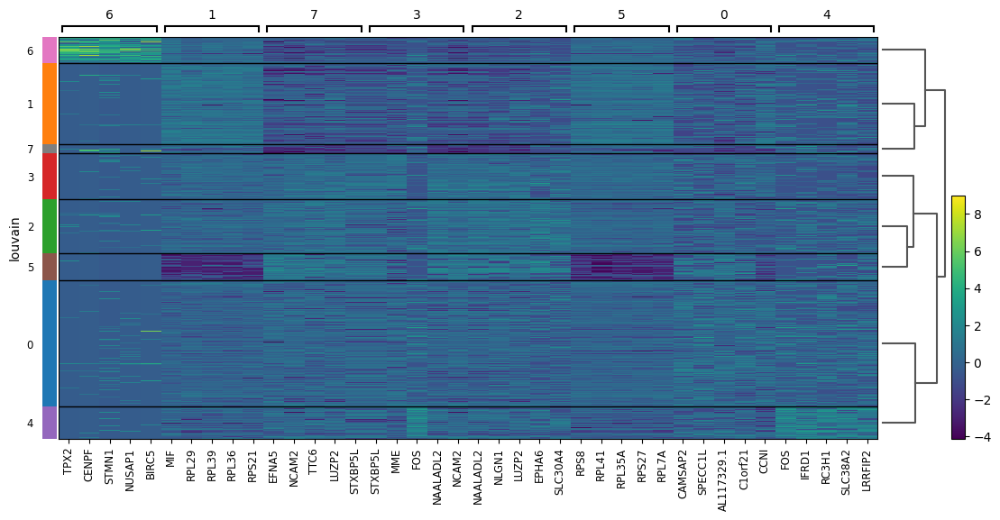

In [44]:
sc.pl.rank_genes_groups_heatmap(clusters, n_genes=5, key="t-test_ov", groupby="louvain", show_gene_labels=True, save="_enz.png")

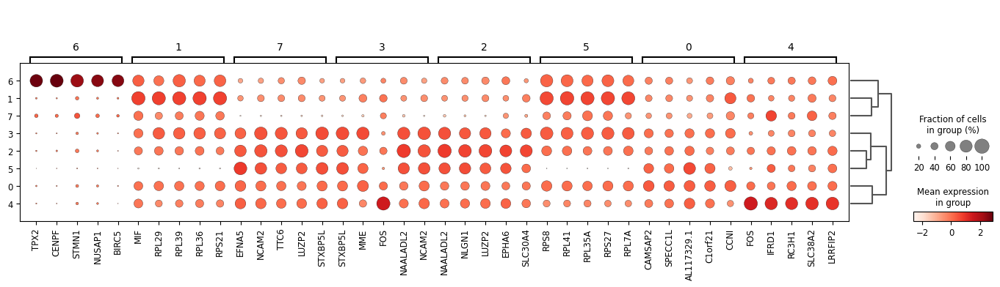

In [45]:
sc.pl.rank_genes_groups_dotplot(clusters, n_genes=5, key="t-test_ov", groupby="louvain", save="_enz.png")

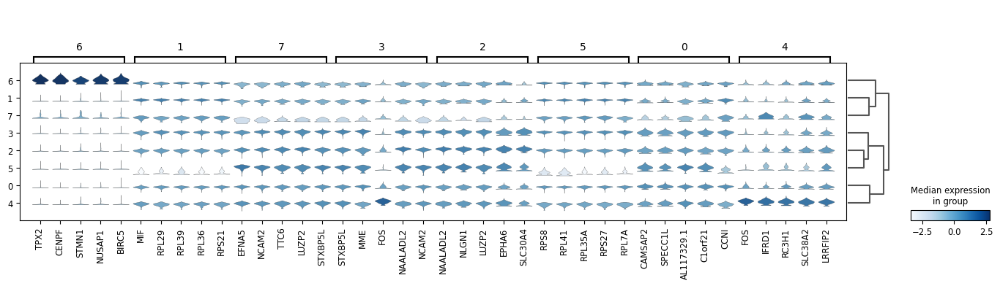

In [46]:
sc.pl.rank_genes_groups_stacked_violin(clusters, n_genes=5, key="t-test_ov", groupby="louvain", save="_enz.png")

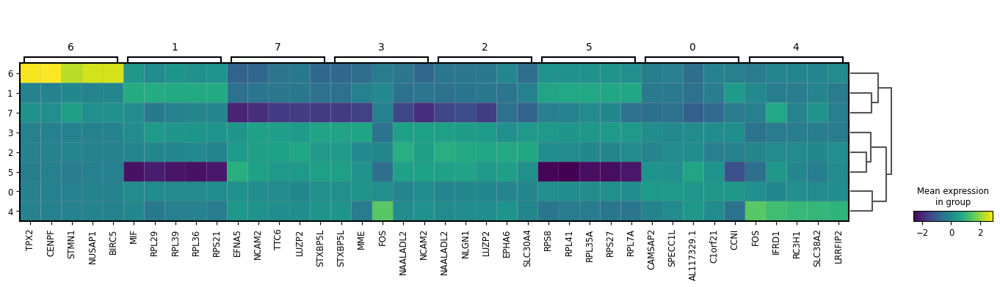

In [47]:
sc.pl.rank_genes_groups_matrixplot(clusters, n_genes=5, key="t-test_ov", groupby="louvain", save="_enz.png")

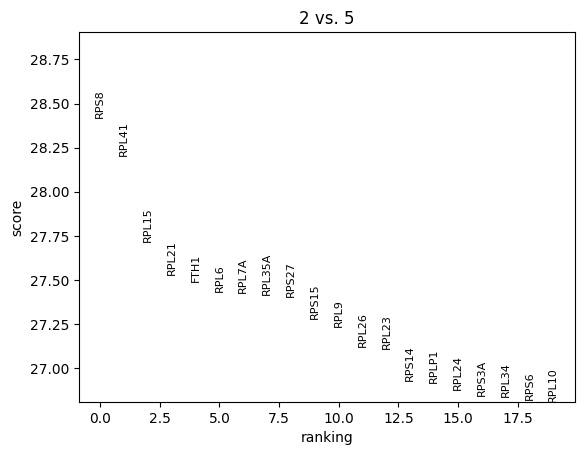

In [48]:
sc.tl.rank_genes_groups(clusters, 'louvain', groups=['2'], reference='5', method='wilcoxon')
sc.pl.rank_genes_groups(clusters, groups=['2'], n_genes=20)

In [49]:
cluster_marker_table.index

RangeIndex(start=0, stop=200, step=1)

In [50]:
# Join two datasets

cluster_joined = pd.merge(cluster_marker_table, markers_cluster.var, left_on='genes', right_index=True)
genotype_joined = pd.merge(genotype_marker_table, markers_genotype.var, left_on='genes', right_index=True)

display(cluster_joined.head(5))
display(genotype_joined.head(5))

,cluster,rank,ref,genes,scores,logfoldchanges,pvals,pvals_adj,gene_ids,feature_types,...,log1p_total_counts,n_counts,n_cells,mito,highly_variable,means,dispersions,dispersions_norm,mean,std
0,0,0,rest,CAMSAP2,18.480614,NaN,2.296607e-73,5.698112e-69,ENSG00000118200,Gene Expression,...,11.261806,77792.0,5315,False,True,1.330904,1.181573,0.701748,1.070664,0.726031
1,1,0,rest,MIF,29.962934,NaN,4.719155e-166,1.170869e-161,ENSG00000240972,Gene Expression,...,13.133341,505518.0,6452,False,False,2.937890,2.013333,0.224449,2.706847,0.792838
2,2,0,rest,NAALADL2,24.181553,NaN,7.806250e-110,1.936809e-105,ENSG00000177694,Gene Expression,...,11.996672,162213.0,6294,False,True,2.434301,2.142412,3.238398,2.091533,0.898374
19,3,2,rest,NAALADL2,13.079020,NaN,8.131371e-37,5.043686e-33,ENSG00000177694,Gene Expression,...,11.996672,162213.0,6294,False,True,2.434301,2.142412,3.238398,2.091533,0.898374
3,3,0,rest,STXBP5L,15.287055,NaN,1.796269e-48,4.456723e-44,ENSG00000145087,Gene Expression,...,12.453562,256160.0,6455,False,True,2.869963,2.269241,1.207314,2.553493,0.903655


,cluster,rank,ref,genes,scores,logfoldchanges,pvals,pvals_adj,gene_ids,feature_types,...,log1p_total_counts,n_counts,n_cells,mito,highly_variable,means,dispersions,dispersions_norm,mean,std
0,enz,0,rest,AC007325.4,0.0,NaN,1.0,1.0,ENSG00000278817,Gene Expression,...,5.375278,215.0,87,False,False,0.010007,0.120187,-0.323817,0.007031,0.067005
1,enz,1,rest,KLHDC3,0.0,NaN,1.0,1.0,ENSG00000124702,Gene Expression,...,8.274357,3921.0,977,False,False,0.126210,0.159530,-0.215265,0.089717,0.239531
2,enz,2,rest,FOXP4,0.0,NaN,1.0,1.0,ENSG00000137166,Gene Expression,...,7.251345,1409.0,446,False,False,0.051268,0.056746,-0.498854,0.036623,0.150817
3,enz,3,rest,ZNF318,0.0,NaN,1.0,1.0,ENSG00000171467,Gene Expression,...,7.498870,1805.0,605,False,False,0.075491,0.137632,-0.275683,0.053185,0.185701
4,enz,4,rest,C6orf226,0.0,NaN,1.0,1.0,ENSG00000221821,Gene Expression,...,7.889084,2667.0,679,False,False,0.091475,0.154150,-0.230109,0.063960,0.206987


In [51]:
# Cut columns from tables

cluster_markers_named = cluster_joined[['cluster', 'ref', 'rank', 'genes', 'scores', 'logfoldchanges', 'pvals', 'pvals_adj']]
genotype_markers_named = genotype_joined[['cluster', 'ref', 'rank', 'genes', 'scores', 'logfoldchanges', 'pvals', 'pvals_adj']]

display(cluster_markers_named.head(5))
display(genotype_markers_named.head(5))

,cluster,ref,rank,genes,scores,logfoldchanges,pvals,pvals_adj
0,0,rest,0,CAMSAP2,18.480614,NaN,2.296607e-73,5.698112e-69
1,1,rest,0,MIF,29.962934,NaN,4.719155e-166,1.170869e-161
2,2,rest,0,NAALADL2,24.181553,NaN,7.806250e-110,1.936809e-105
19,3,rest,2,NAALADL2,13.079020,NaN,8.131371e-37,5.043686e-33
3,3,rest,0,STXBP5L,15.287055,NaN,1.796269e-48,4.456723e-44


,cluster,ref,rank,genes,scores,logfoldchanges,pvals,pvals_adj
0,enz,rest,0,AC007325.4,0.0,NaN,1.0,1.0
1,enz,rest,1,KLHDC3,0.0,NaN,1.0,1.0
2,enz,rest,2,FOXP4,0.0,NaN,1.0,1.0
3,enz,rest,3,ZNF318,0.0,NaN,1.0,1.0
4,enz,rest,4,C6orf226,0.0,NaN,1.0,1.0


In [52]:
cluster_markers_named.head(10)

,cluster,ref,rank,genes,scores,logfoldchanges,pvals,pvals_adj
0,0,rest,0,CAMSAP2,18.480614,NaN,2.296607e-73,5.698112e-69
1,1,rest,0,MIF,29.962934,NaN,4.719155e-166,1.170869e-161
2,2,rest,0,NAALADL2,24.181553,NaN,7.806250e-110,1.936809e-105
19,3,rest,2,NAALADL2,13.079020,NaN,8.131371e-37,5.043686e-33
3,3,rest,0,STXBP5L,15.287055,NaN,1.796269e-48,4.456723e-44
4,4,rest,0,FOS,26.444717,NaN,2.529402e-118,6.275700e-114
5,5,rest,0,KDM6A,19.403751,NaN,1.517145e-70,1.991634e-68
6,6,rest,0,TPX2,30.375950,NaN,9.179306e-114,2.277478e-109
7,7,rest,0,DDIT3,11.285053,NaN,3.132541e-23,3.886074e-20
8,0,rest,1,SPECC1L,15.907378,NaN,2.251018e-55,2.792500e-51


In [53]:
sorted_markers = cluster_markers_named.sort_values(by='scores', ascending=False)

In [54]:
sorted_markers.head(100)

,cluster,ref,rank,genes,scores,logfoldchanges,pvals,pvals_adj
6,6,rest,0,TPX2,30.375950,NaN,9.179306e-114,2.277478e-109
14,6,rest,1,CENPF,30.242653,NaN,7.256743e-112,9.002352e-108
1,1,rest,0,MIF,29.962934,NaN,4.719155e-166,1.170869e-161
9,1,rest,1,RPL29,29.510344,NaN,1.583787e-163,1.964768e-159
17,1,rest,2,RPL39,28.505430,NaN,6.962459e-153,5.758186e-149
...,...,...,...,...,...,...,...,...
61,5,rest,7,EFNA5,14.049230,NaN,9.420341e-41,6.834154e-39
98,2,rest,12,AC022034.3,14.014373,NaN,2.882023e-42,5.500452e-39
106,2,rest,13,BMPR1B,13.965619,NaN,4.036282e-42,7.153157e-39
104,0,rest,13,RBL2,13.964852,NaN,2.346557e-43,4.158602e-40


# Get top expressed genes for each cluster

In [55]:
import math

def plot_embedding_with_title(adata, basis, colors, title, save_title, use_raw=False, nrows=None, ncols=None):
    """
    Plots the embeddings for given colors and adds a title for the entire figure.
    
    Parameters:
    - adata: AnnData object containing the data
    - basis: str, basis for the embedding (e.g., 'tsne', 'umap')
    - colors: list of str, names of the annotations or genes to color the plots by
    - title: str, title for the entire figure
    - use_raw: bool, whether to use the raw attribute of adata
    - nrows: int, number of rows in the grid
    - ncols: int, number of columns in the grid
    """
    num_plots = len(colors)
    
    if nrows is None and ncols is None:
        # Default to a square-ish grid if not specified
        nrows = math.ceil(math.sqrt(num_plots))
        ncols = math.ceil(num_plots / nrows)
    elif nrows is None:
        nrows = math.ceil(num_plots / ncols)
    elif ncols is None:
        ncols = math.ceil(num_plots / nrows)
    
    fig, axes = plt.subplots(nrows, ncols, figsize=(5 * ncols, 5 * nrows))
    axes = axes.flatten()  # Flatten the axes array for easy iteration

    for i, color in enumerate(colors):
        sc.pl.embedding(
            adata,
            basis=basis,
            color=color,
            use_raw=use_raw,
            ax=axes[i],
            show=False
        )
    
    # Remove any empty subplots
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])
    
    fig.suptitle(title, fontsize=16)
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)  # Adjust the top to make space for the title
    plt.savefig(save_title)
    plt.show()

Top genes in cluster 0


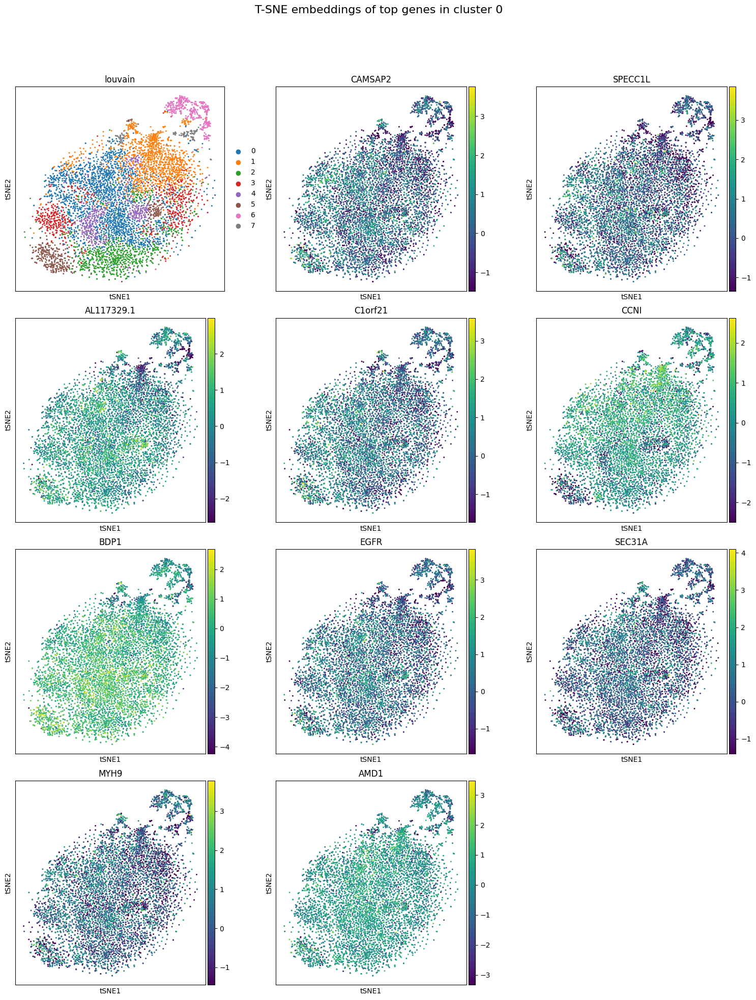

Top genes in cluster 1


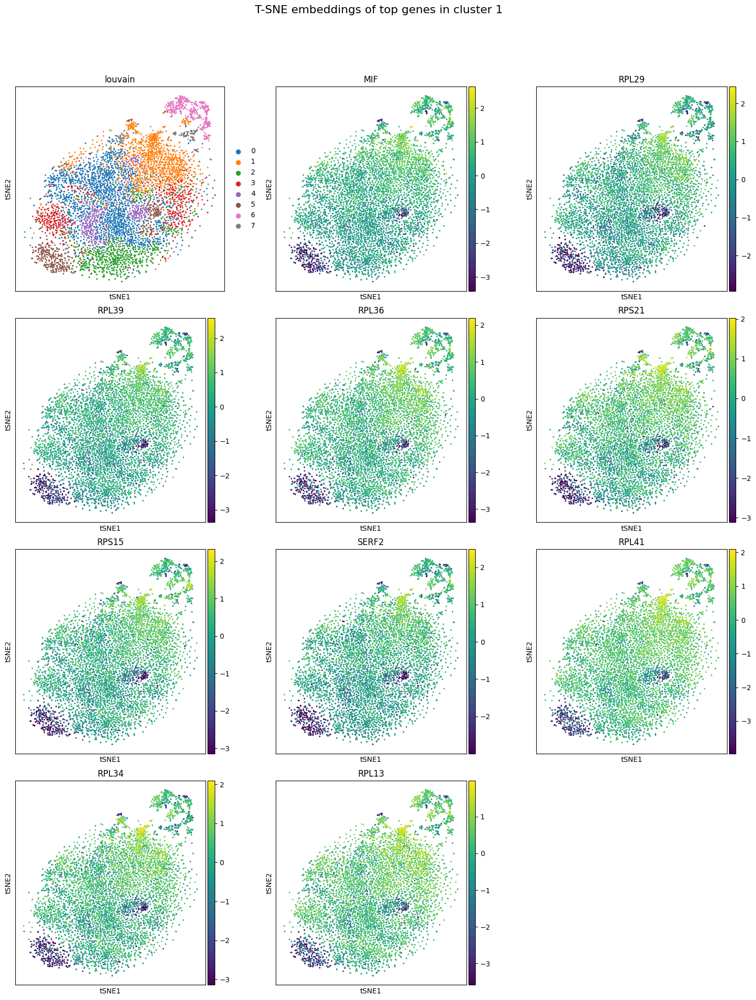

Top genes in cluster 2


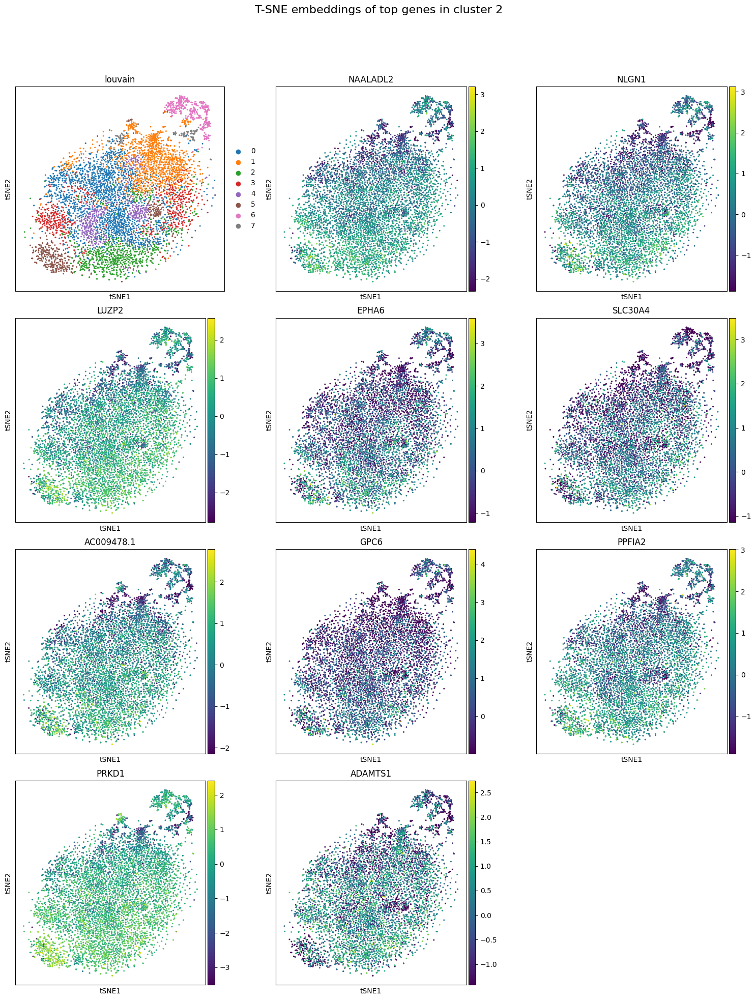

Top genes in cluster 3


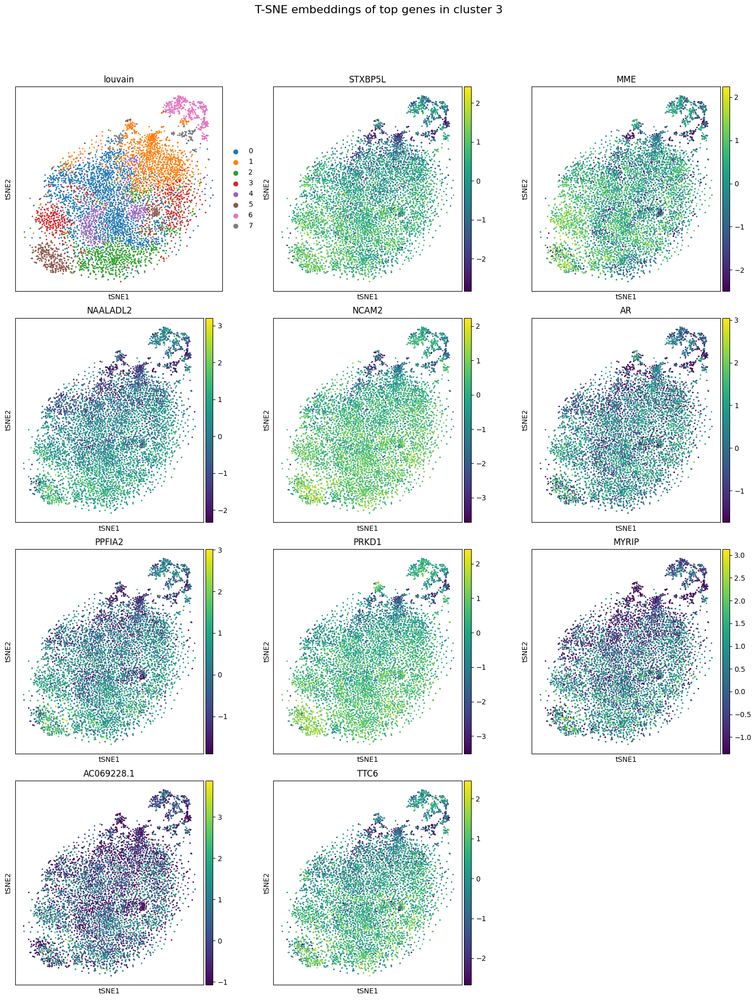

Top genes in cluster 4


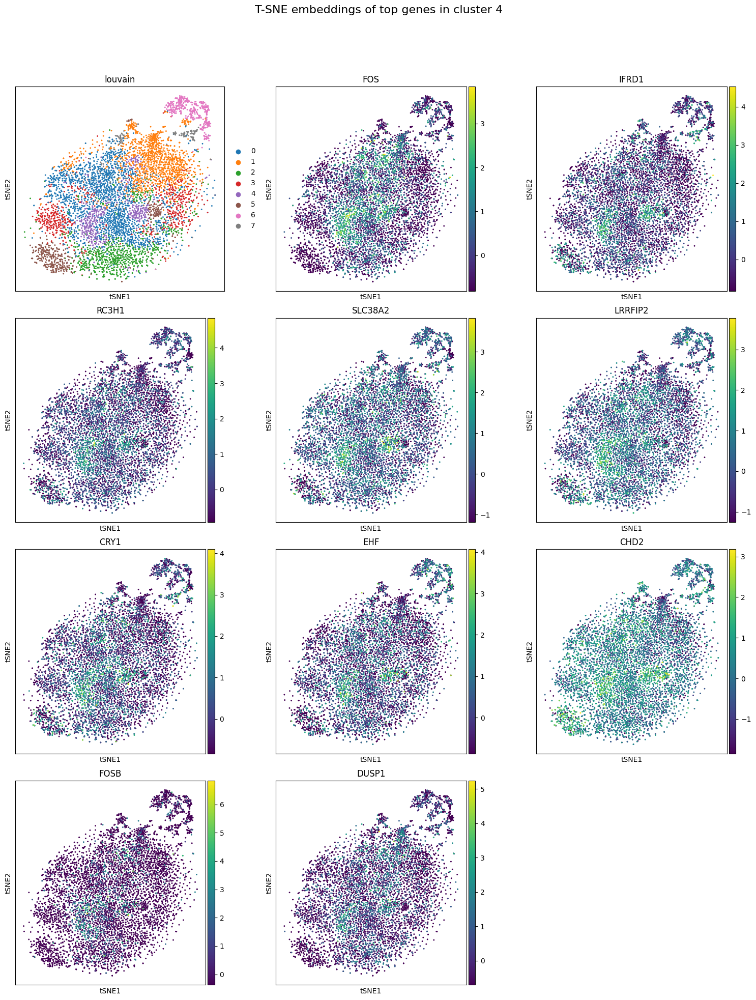

Top genes in cluster 5


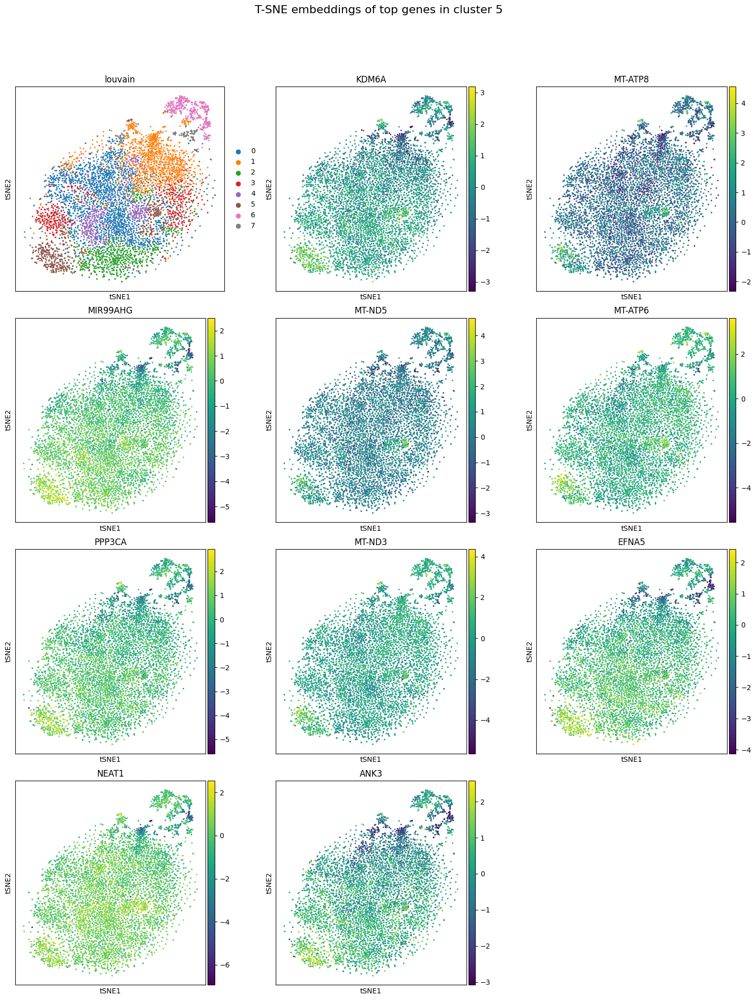

Top genes in cluster 6


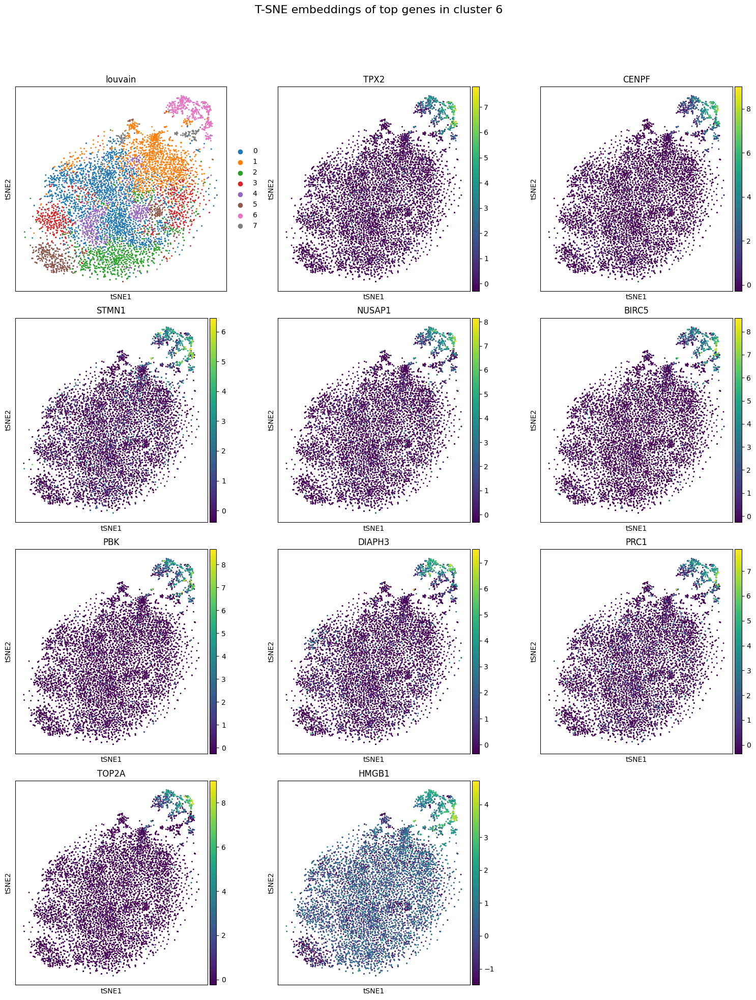

Top genes in cluster 7


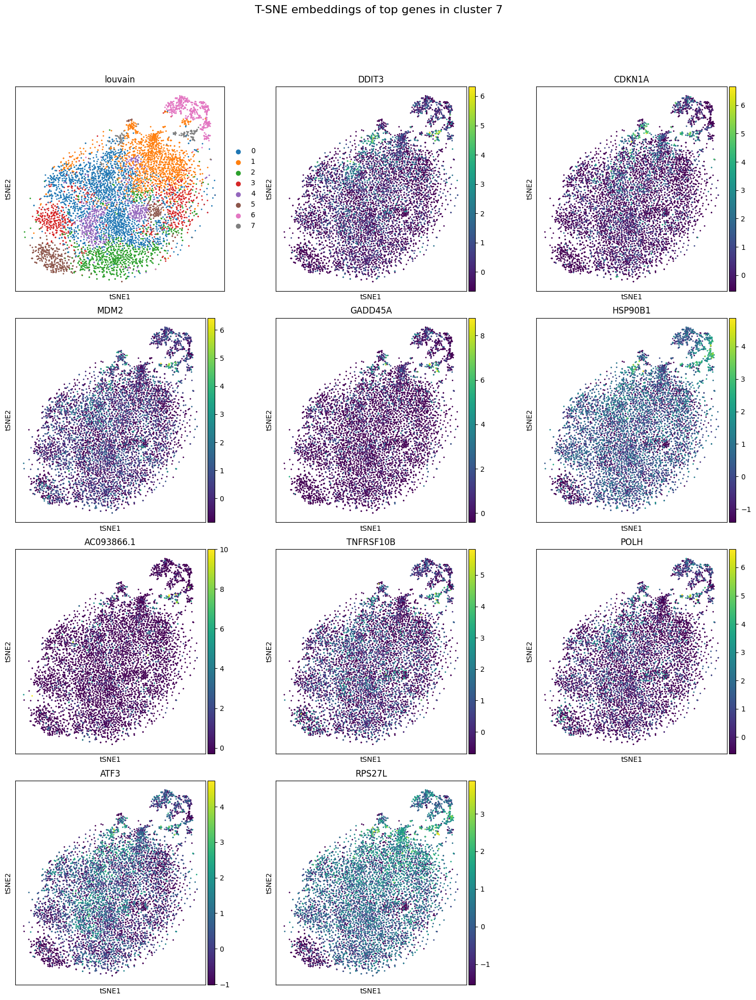

In [56]:
def get_top_n_by_cluster(df, n):
    return df.groupby('cluster').apply(lambda x: x.nlargest(n, 'scores')).reset_index(drop=True)

top_n = 10
top_cluster_genes = get_top_n_by_cluster(cluster_markers_named, top_n)

top_n_genes_dict = top_cluster_genes.groupby('cluster')['genes'].apply(list).to_dict()

for k, v in top_n_genes_dict.items():
    print(f'Top genes in cluster {k}')
    plot_embedding_with_title(
        adata=markers_cluster,
        basis='tsne',
        colors=['louvain', *v],
        title=f'T-SNE embeddings of top genes in cluster {k}',
        save_title=f'images/enz/top_genes_cluster_{k}',
        use_raw=False
    )

# Get top globally expressed genes

In [57]:
top_markers = sorted_markers.head(100).genes.tolist()

In [58]:
marker_table = pd.DataFrame([top_markers[i:i + 5] for i in range(0, len(top_markers), 5)])
marker_table.to_excel('output.xlsx', header=False, index=False)

# Plot Embeddings

In [59]:
sc.set_figure_params(figsize=(5,5), dpi=200, dpi_save=200)

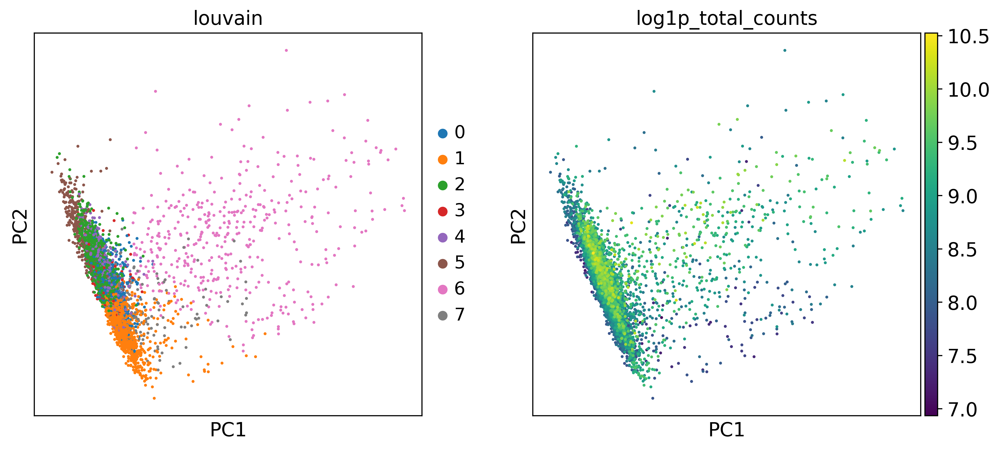

In [60]:
# PCA
sc.pl.embedding(
    markers_cluster,
    basis='pca',  
    color=['louvain','log1p_total_counts'],
    use_raw=False,
    save='.png'
)

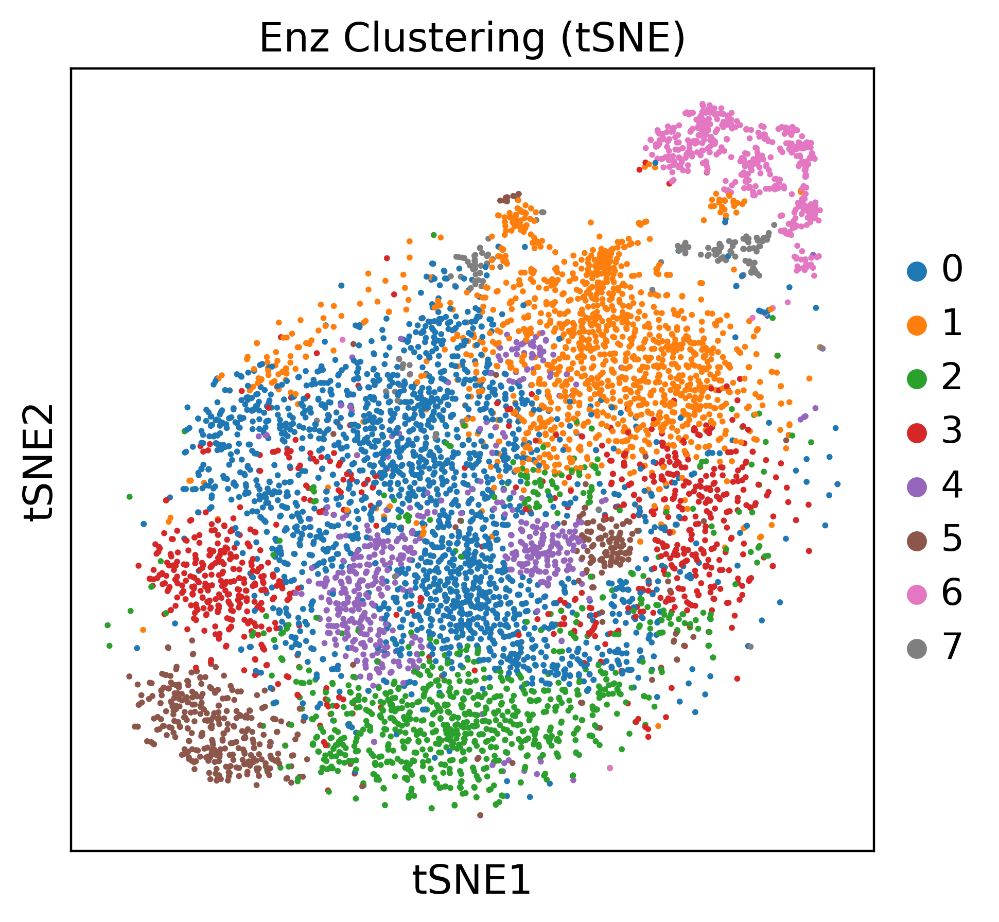

In [61]:
# TSNE
sc.pl.embedding(
    markers_cluster,
    title='Enz Clustering (tSNE)',
    basis='tsne',  
    color=['louvain'],
    use_raw=False,
    save='.png'
)

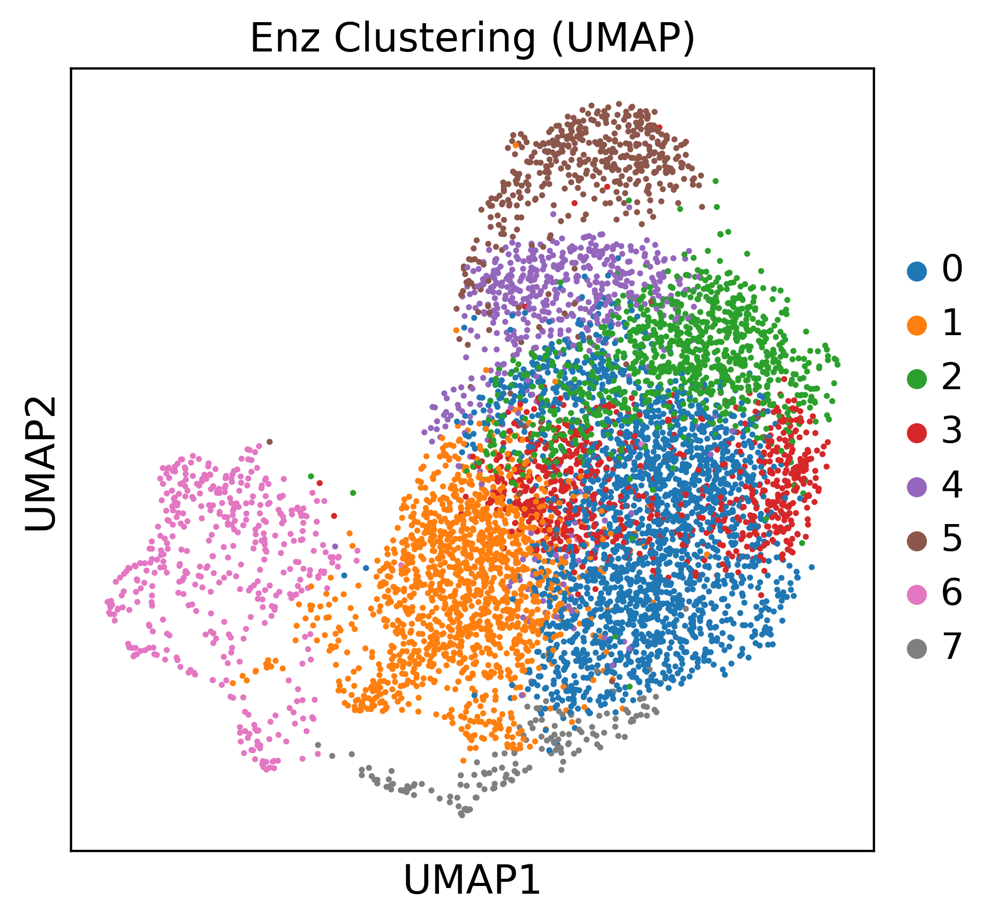

In [62]:
# UMAP
sc.pl.embedding(
    markers_cluster,
    title='Enz Clustering (UMAP)',
    basis='umap',  
    color=['louvain'],
    use_raw=False,
    save='.png'
)

In [64]:
#markers_cluster.write_h5ad('anndata-objects/enz.h5ad')